<a href="https://colab.research.google.com/github/SiegfredLorelle/digital-image-processing/blob/main/lab01_introduction-to-image-processing/notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Laboratory Activity: Introduction to Image Processing using Python in Google Collab

## Members:
- Amad, Harold P.
- De Padua, Angelo Miguel N.
- Fabro, Gaeus Caskie A.
- Mina, Siegfred Lorelle C.

## Step 1-3 Access the Colab Notebook, Review the Notebook Structure, Execute Code Cells


### **Introduction to Image Processing in Python**
An NCSU Libraries Workshop

Speaker: Nian Xiong

>This workshop intends to provide some basic image processing techniques based on OpenCV library and some standard data analysis libraries of python. Knowledge of image processing and python programming is not required for this seminar, but will help.


*The source of this notebook is located at https://github.com/xn2333/OpenCV/blob/master/Seminar_Image_Processing_in_Python.ipynb*

*Useful intro about [Colab](https://colab.research.google.com/notebooks/welcome.ipynb)*

*Useful intro about [OpenCV](https://opencv.org/)*








### Step1: Load the Dependencies

> This section loads some required libraries used in this notebook: **numpy**, **pandas**, **cv2**, **skimage**, **PIL**, **matplotlib**

*   [Numpy](https://www.numpy.org/) is an array manipulation library, used for linear algebra, Fourier transform, and random number capabilities.
*   [Pandas](https://pandas.pydata.org/) is a library for data manipulation and data analysis.
*   [CV2](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_gui/py_image_display/py_image_display.html) is a library for computer vision tasks.
*   [Skimage](https://scikit-image.org/) is a library which supports image processing applications on python.
*   [Matplotlib](https://matplotlib.org/) is a library which generates figures and provides graphical user interface toolkit.









In [183]:
import numpy as np
import pandas as pd
import cv2 as cv
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image
import matplotlib.pylab as plt

###Step2: Read Image from Urls

> In this step we will read images from urls, and display them using openCV, please note the difference when reading image in RGB and BGR format. The default input color channels are in BGR format for openCV.

RGB?

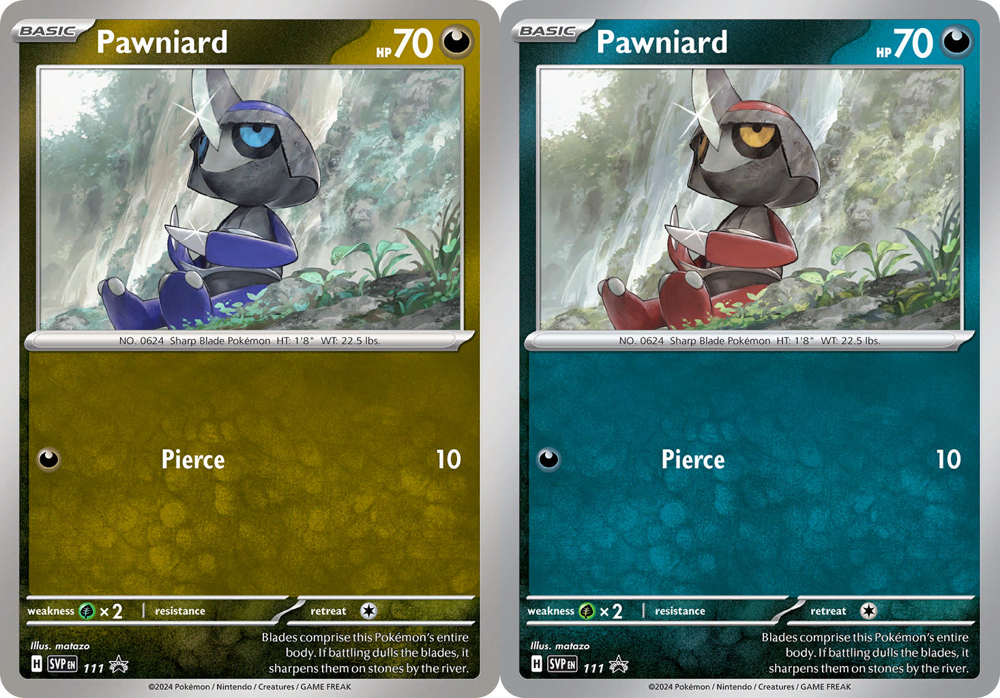

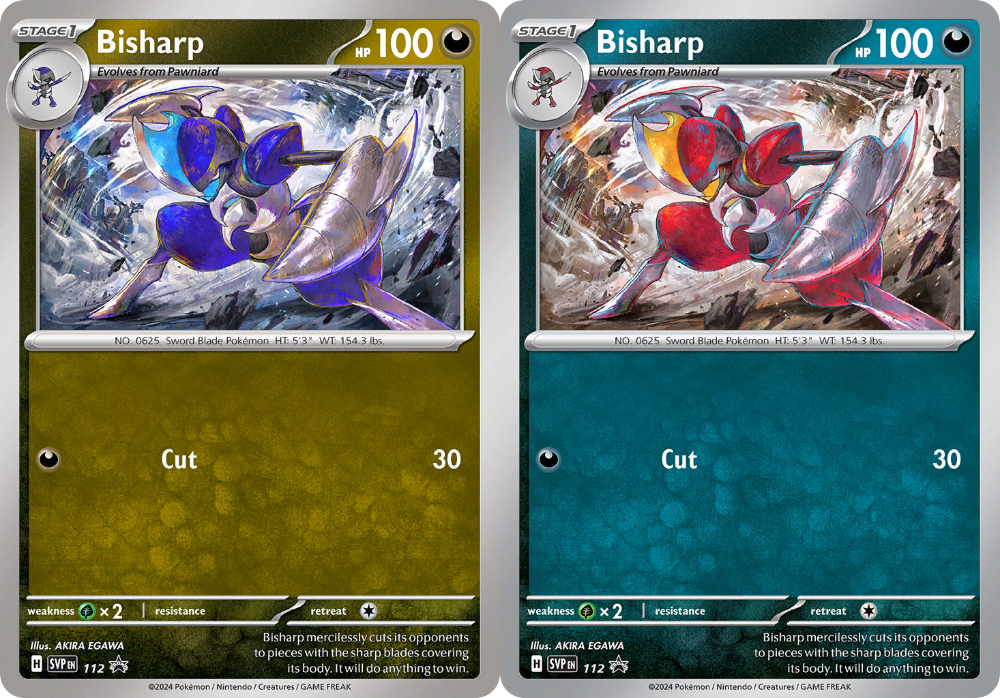

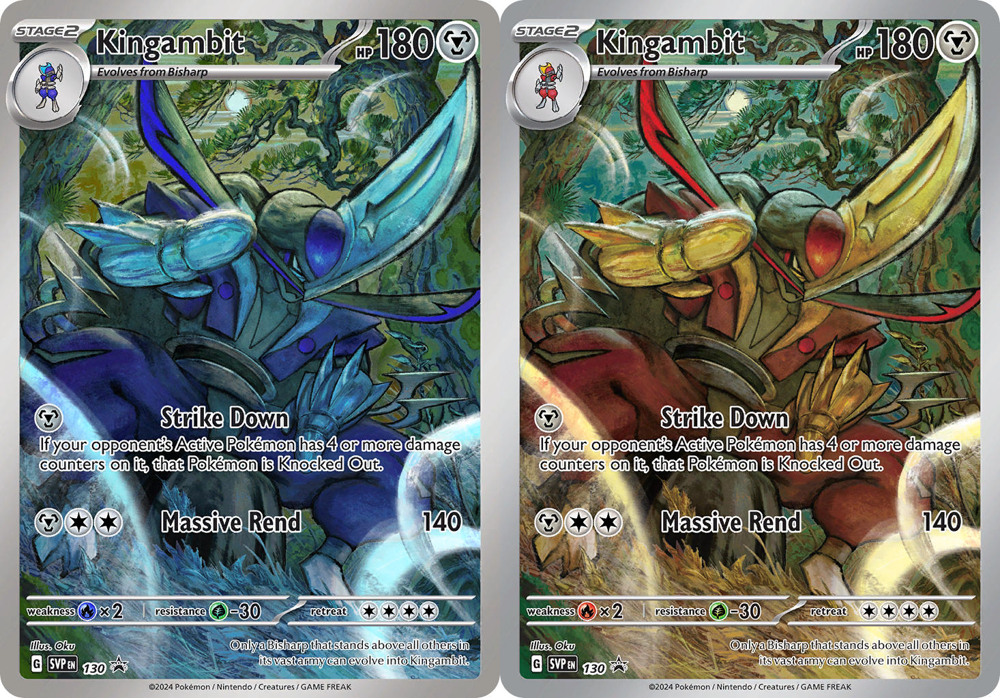

In [184]:
# Create a list to store the urls of the images
# NOTE: Image URLs were replaced with our own
# Since some have broken links (and for practice as well)
url1 = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/pawniard.jpg"
url2 = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/bisharp.jpg"
url3 = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/kingambit.jpg"
urls = [url1, url2, url3]

# Read and display the image
# loop over the image URLs, you could store several image urls in the list

for url in urls:
  image = io.imread(url)
  image_2 = cv.cvtColor(image, cv.COLOR_BGR2RGB)
  final_frame = cv.hconcat((image, image_2))
  cv2_imshow(final_frame)
  print('\n')

#### TODO #1: Read image from a website you like and display it
[PlaceKitten](https://placekitten.com/)

[LibraryCollections](https://d.lib.ncsu.edu/collections/catalog?f%5Btopic_facet%5D%5B%5D=Campus+and+Town)



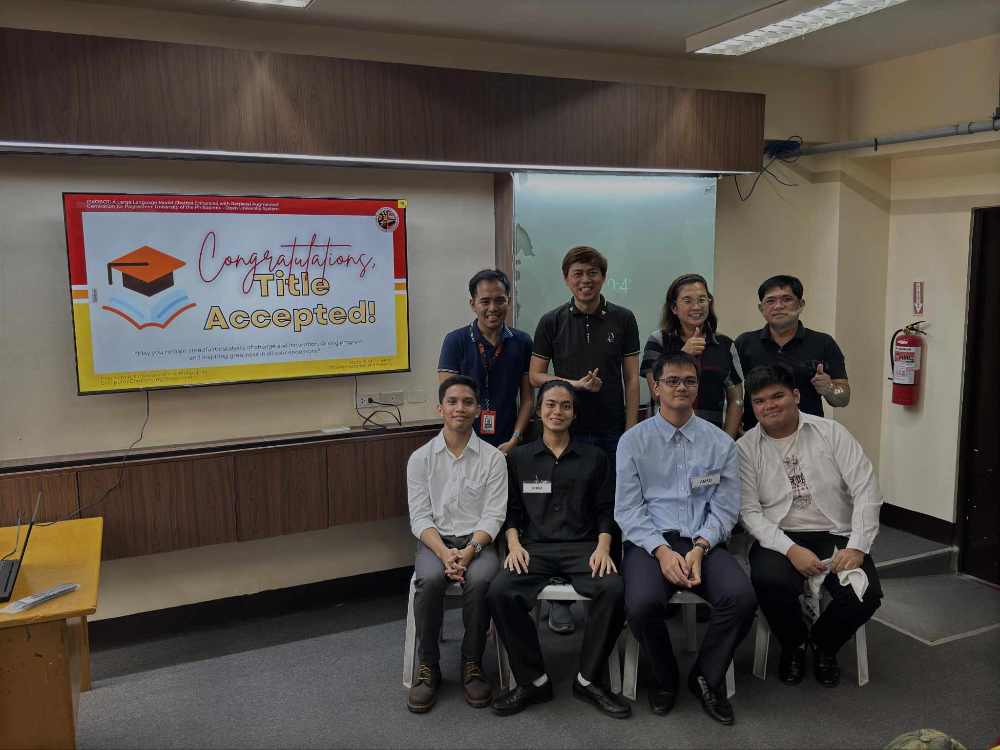

In [185]:
# TODO: LOAD IMAGE
url = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/us.jpg"
myImg = io.imread(url)
cv2_imshow(cv.cvtColor(myImg, cv.COLOR_BGR2RGB))

###Step3: Image Contours and Histograms

In [186]:
# Check the image matrix data type (could know the bit depth of the image)
print(image.dtype)
# Check the height of image
print(image.shape[0])
# Check the width of image
print(image.shape[1])
# Check the number of channels of the image
print(image.shape[2])

uint8
1024
733
3


### Generate Histogram of color image and grayscale image
Sometimes you want to enhance the contrast in your image, or expand the contrast in a particular region while sacrificing the detail in colors that don’t vary much, or don’t matter. A good tool to find interesting regions is the histogram. To create a histogram of our image data, we use the hist() function of matplot pylab
More info: [Histogram](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_histograms/py_table_of_contents_histograms/py_table_of_contents_histograms.html)

Display the histogram of all the pixels in the color image

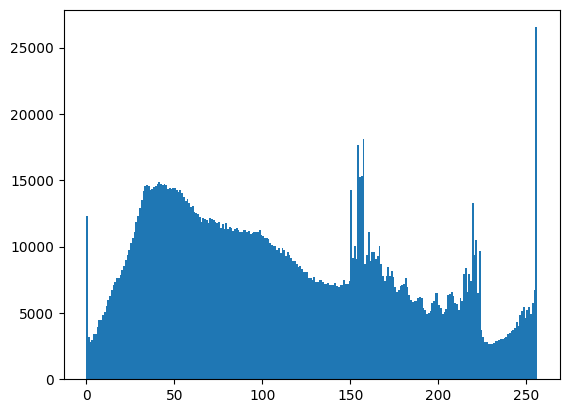

In [187]:
plt.hist(image.ravel(),bins = 256, range = [0,256])
plt.show()

Display the histogram of R, G, B channel
We could observe that the green channel has many pixels in 255, which represents the white patch in the image

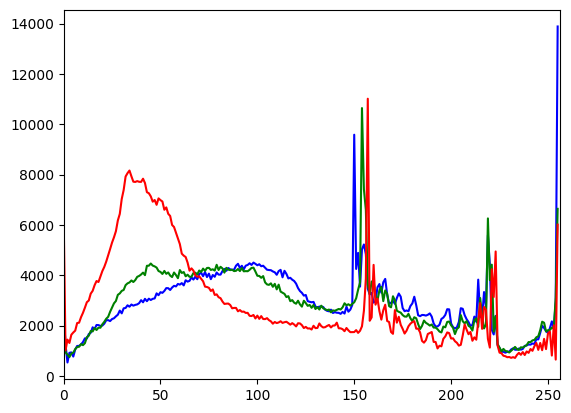

In [188]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

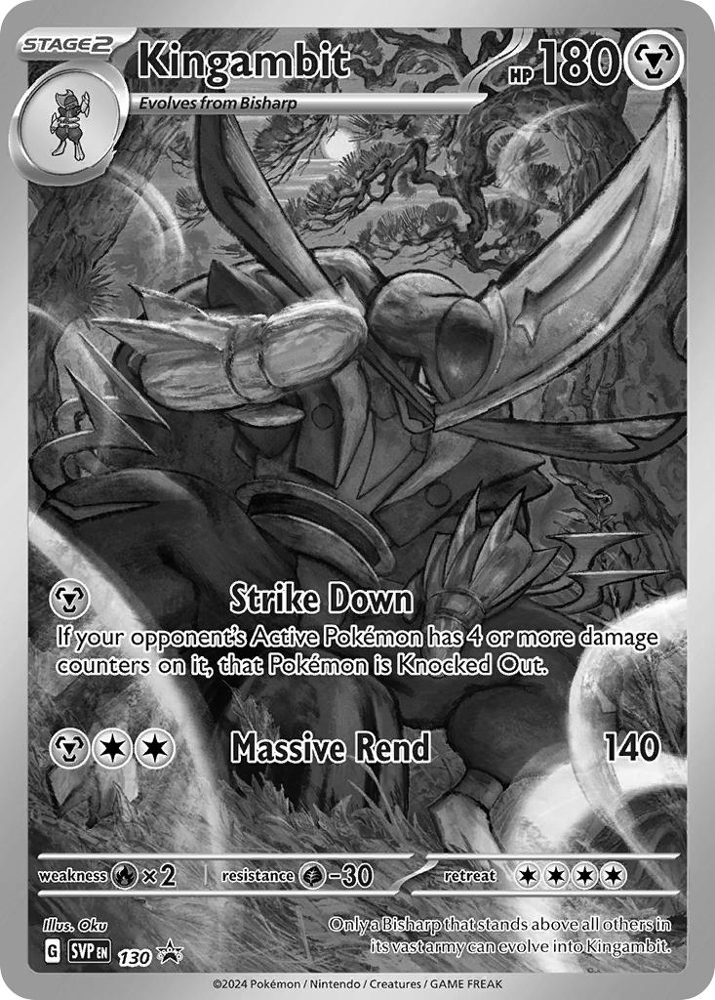

In [189]:
gray_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
cv2_imshow(gray_image)

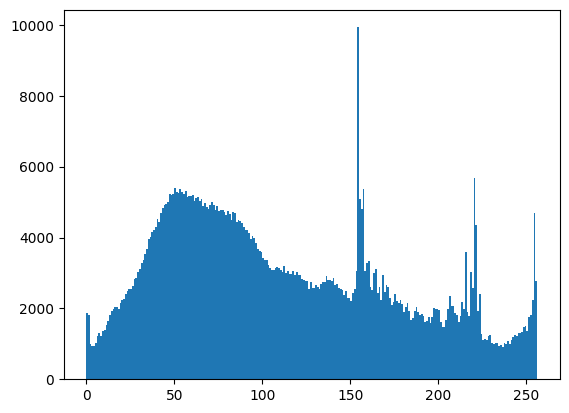

In [190]:
# Plot the histogram of the gray image. We could observe that the frequency of the image hist has decreased ~ 1/3 of the histogram of color image
plt.hist(gray_image.ravel(),bins = 256, range = [0, 256])
plt.show()

 #### TODO # 2: DISPLAY THE GRAYSCALE OF YOUR COLOR IMAGE AND GENERATES HISTOGRAM


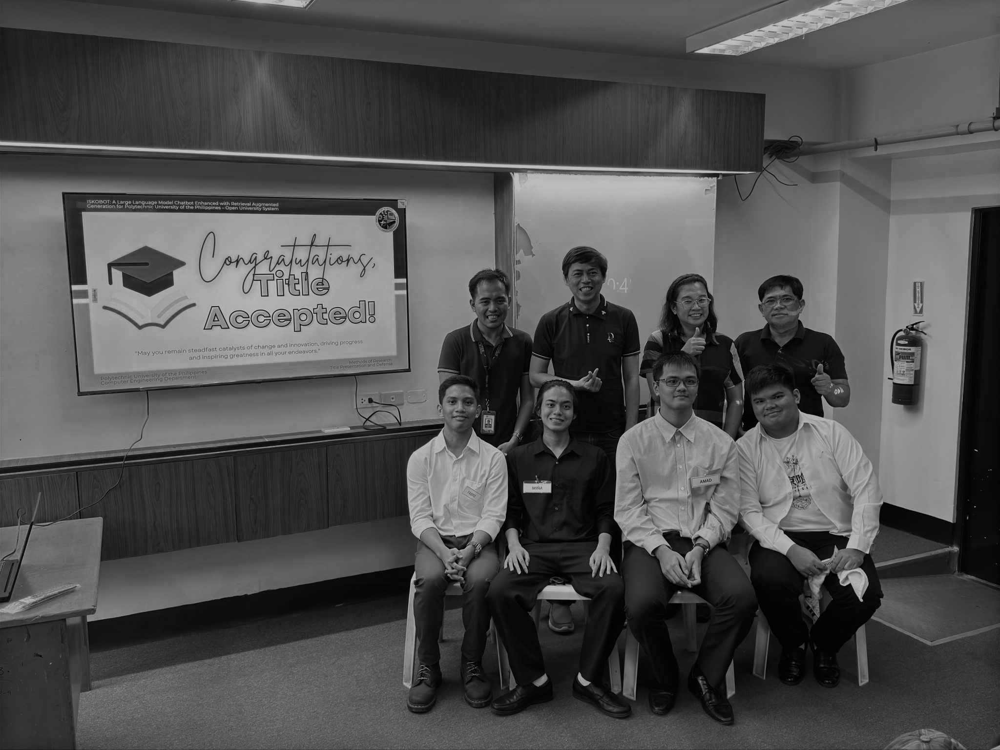

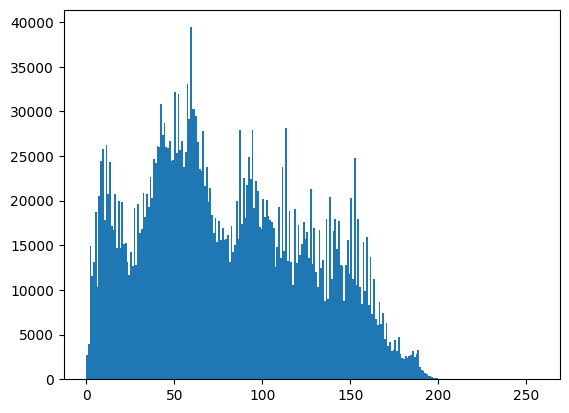

In [191]:
myGrayImg = cv.cvtColor(myImg, cv.COLOR_BGR2GRAY)
cv2_imshow(myGrayImg)

plt.hist(myGrayImg.ravel(),bins = 256, range = [0, 256])
plt.show()


### Find image contour of the grayscale image

Method 1: Use the matplotlib. contour

More Info: [matplotlib contour](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.contour.html)

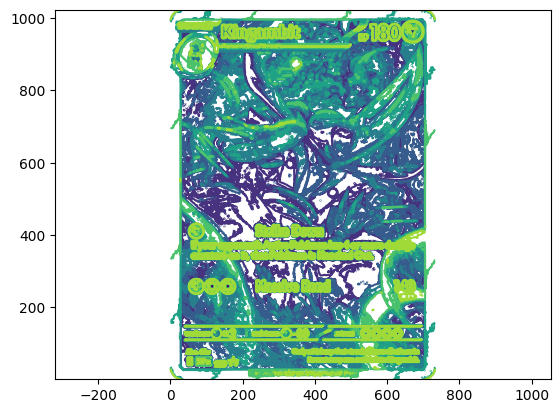

In [192]:
plt.contour(gray_image, origin="image")
plt.axis('equal')
plt.show()

Method 2: Use the openCV lib

More info: [Contour](https://docs.opencv.org/3.1.0/d4/d73/tutorial_py_contours_begin.html)

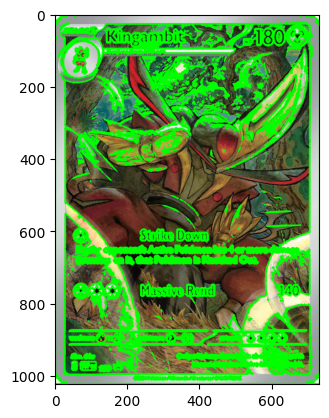

In [193]:
# Set threshold for the countour detection
ret, thresh = cv.threshold(gray_image,150,255,0)
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
cv.drawContours(image, contours, -1, (0, 255, 0), 3)
plt.imshow(image)

#### TODO # 3: Find the contour of your own image

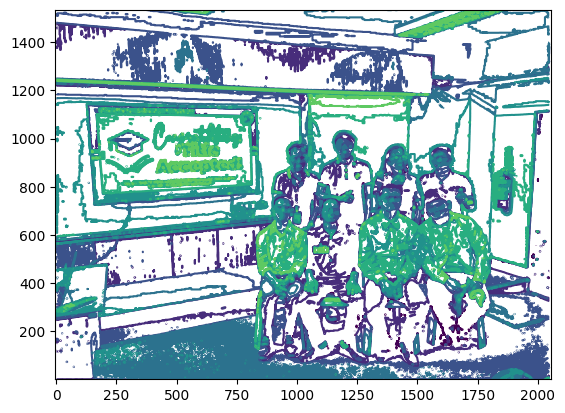

In [194]:
# Your code
plt.contour(myGrayImg, origin="image")
plt.axis('equal')
plt.show()

###Step4: Grayscale Transform and Histogram Equalization


### Grayscale Transformation
This section provides some examples of conducting mathematical transformations of the grayscale image

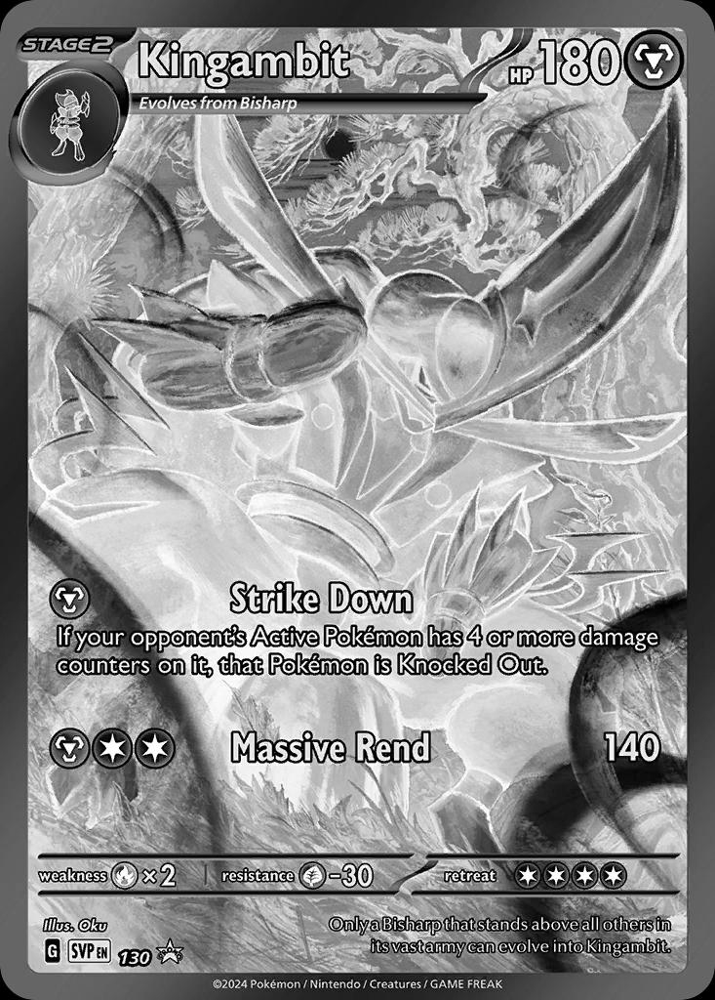

In [195]:
# This is an inverse operation of the grayscale image, you could see that the bright pixels become dark, and the dark pixels become bright
im2 = 255 - gray_image
cv2_imshow(im2)

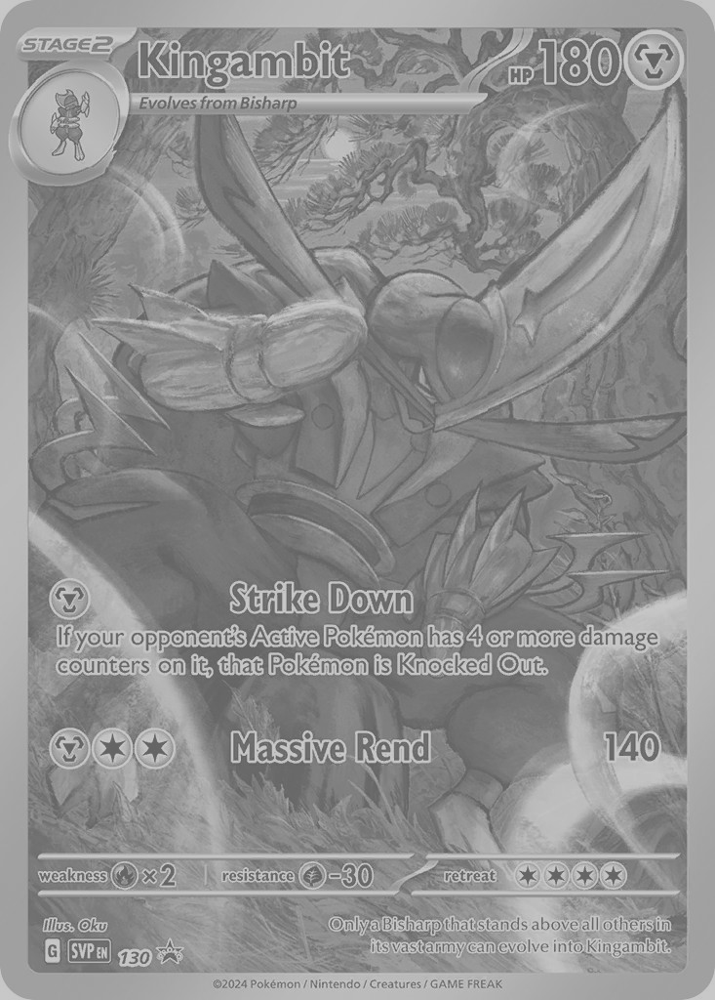

In [196]:
# Another transform of the image, after adding a constant,
# all the pixels become brighter and a hazing-like effect of the image is generated
im3 = (100.0/255)*gray_image + 100
cv2_imshow(im3)

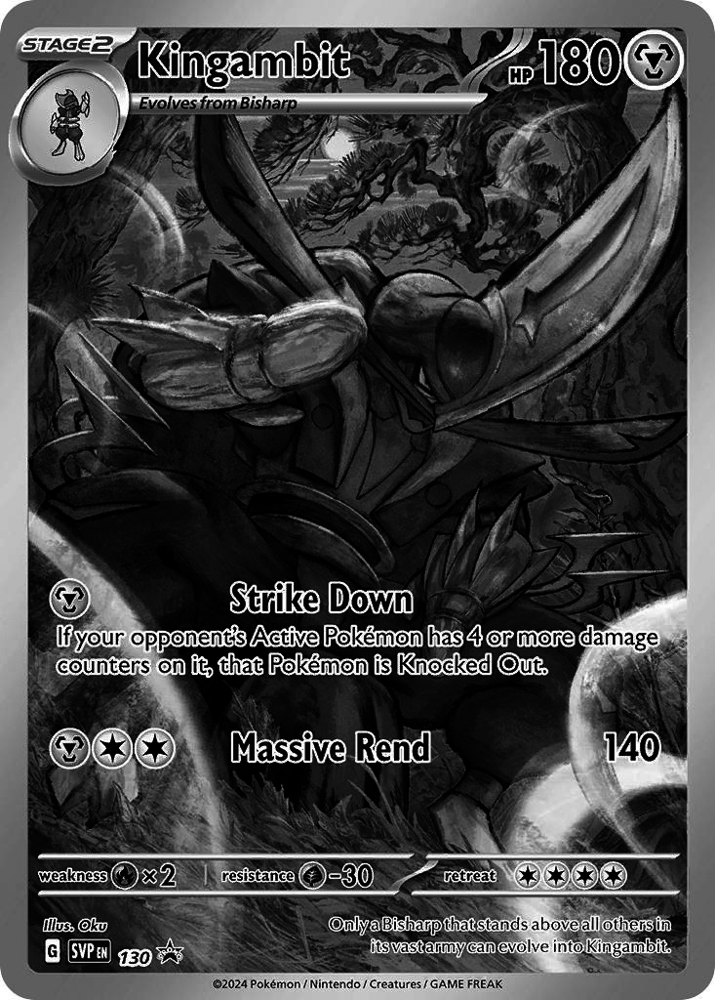

In [197]:
# The lightness level of the gray_image decreases after this step
im4 = 255.0*(gray_image/255.0)**2
cv2_imshow(im4)

#### TODO #4:  Try some mathematical operations on your image


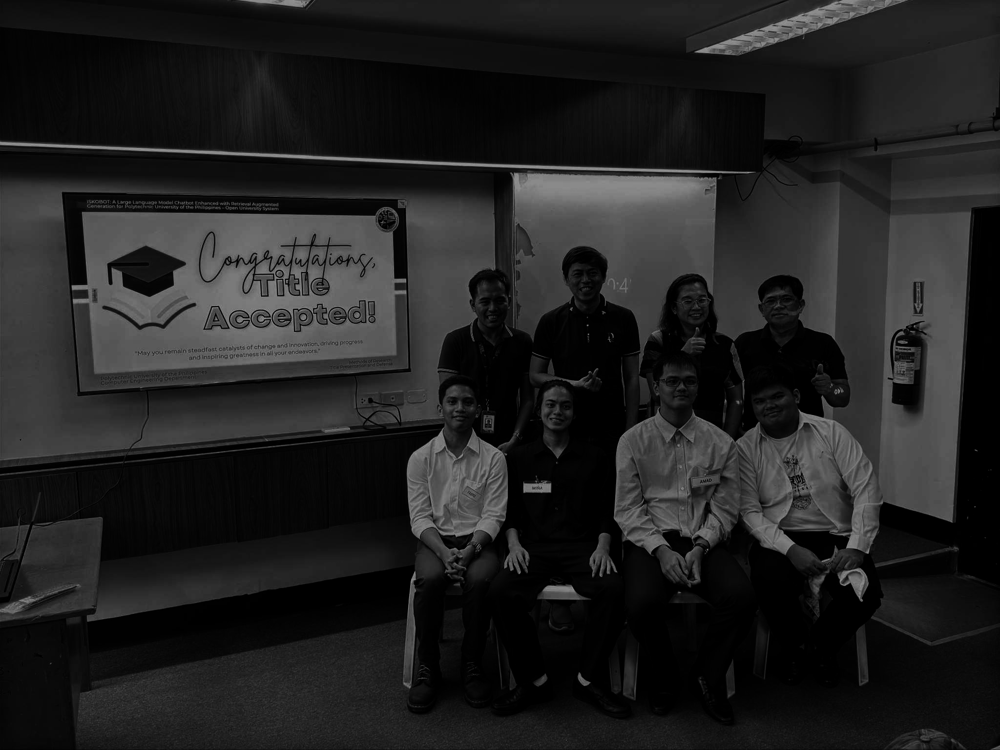

In [198]:
## Implement your code here
myGrayImgTrans = 255.0*(myGrayImg/255.0)**2
cv2_imshow(myGrayImgTrans)

### Histogram Equalization
This section demonstrates the histogram quealization on a dark image. This transform flattens the graylevel histogram so that all intensities are as equally common as possible. The transform function is, a cumulative distribution function(cdf) of the pixel values in the image(normalized to map the range of pixel values to the desired range). Use the image 4 as an example.

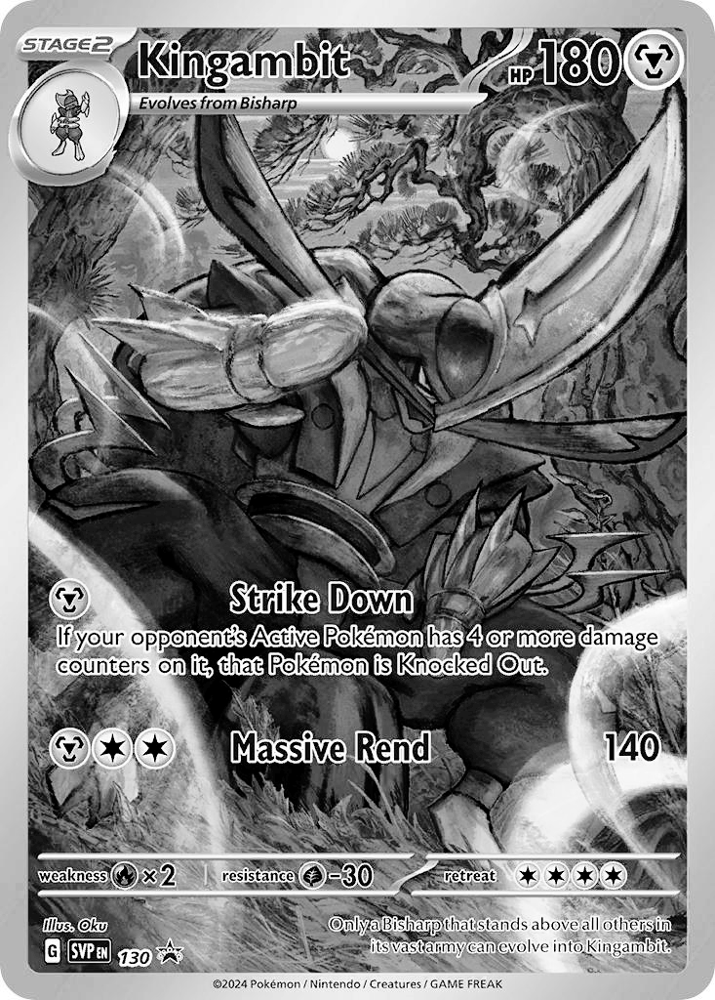

In [199]:
# function of histogram equalization
def histeq(im, nbr_bins = 256):
  """ Histogram equalization of a grayscale image.  """
  # get the image histogram
  imhist, bins = np.histogram(im.flatten(), nbr_bins, [0, 256])
  cdf = imhist.cumsum() # cumulative distribution function
  cdf = imhist.max()*cdf/cdf.max()  #normalize
  cdf_mask = np.ma.masked_equal(cdf, 0)
  cdf_mask = (cdf_mask - cdf_mask.min())*255/(cdf_mask.max()-cdf_mask.min())
  cdf = np.ma.filled(cdf_mask,0).astype('uint8')
  return cdf[im.astype('uint8')]

# apply the function on your dark image to increase the contrast
# we could observe that the contrast of the black background has increased
im5 = histeq(im4)
cv2_imshow(im5)

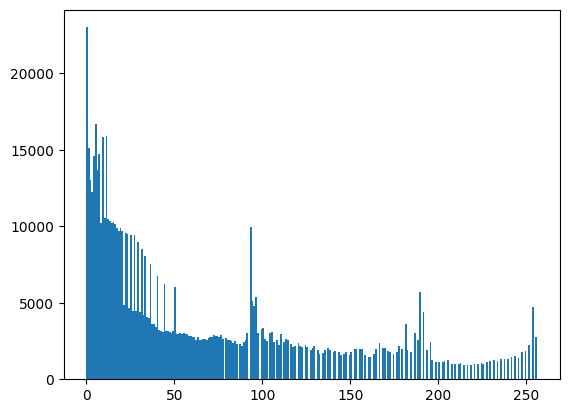

In [200]:
# Extra: try to visualize the histogram of the image after histogram equalization
# Before histogram equalization
plt.hist(im4.ravel(),bins = 256, range = [0, 256])
plt.show()

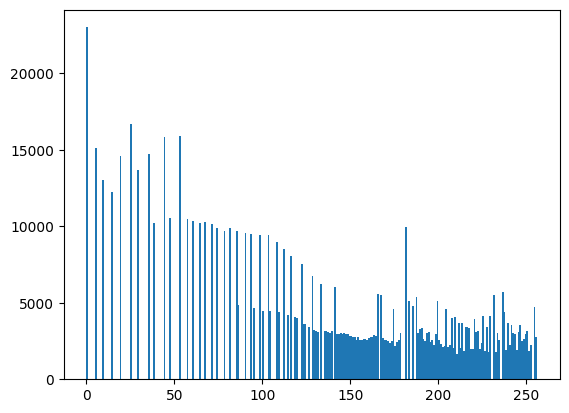

In [201]:
# After histogram equalization
plt.hist(im5.ravel(),bins = 256, range = [0, 256])
plt.show()

#### TODO # 5: Do a histogram equalization on your grayscale image



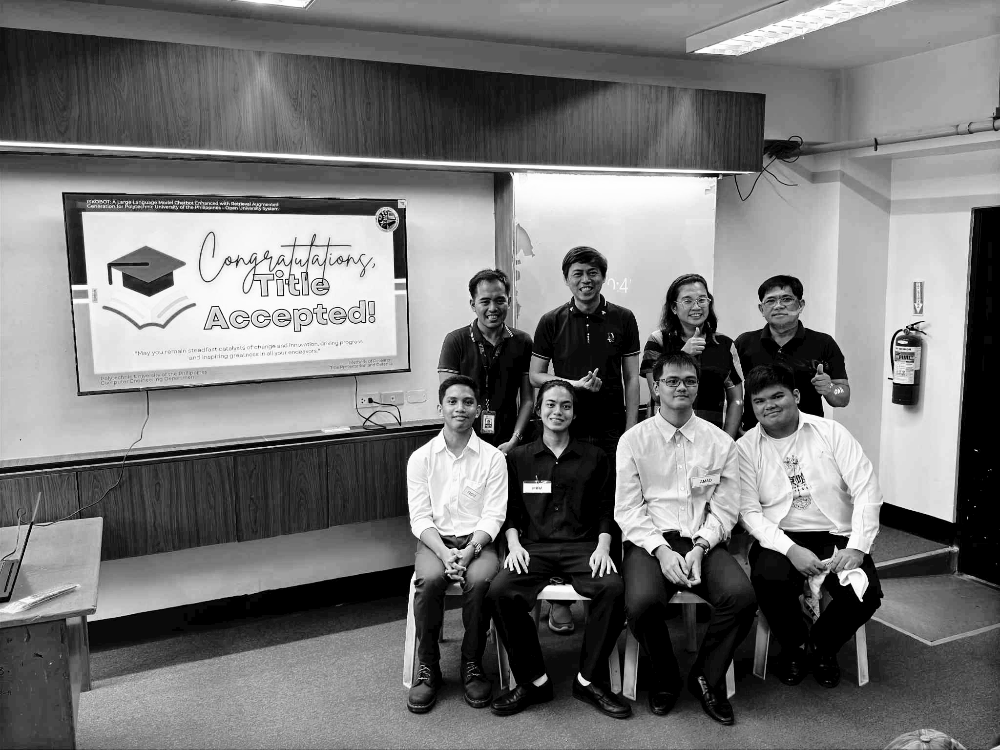

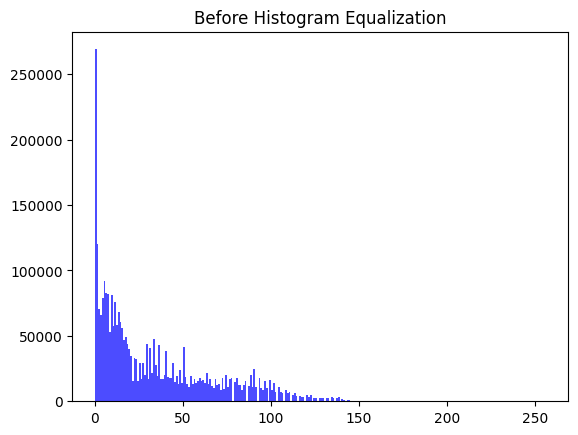

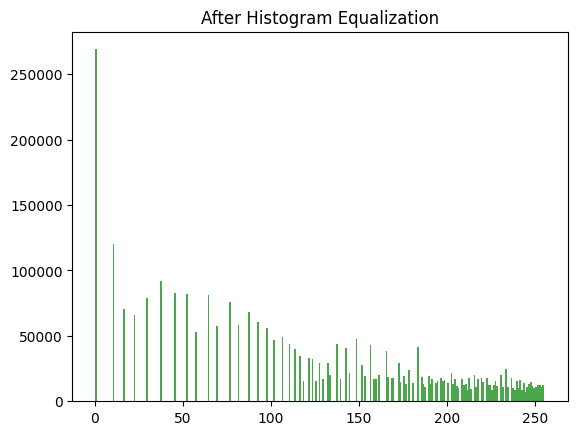

In [202]:
## TODO: IMPLEMENT YOUR CODE HERE
# function of histogram equalization
def histeq(im, nbr_bins = 256):
  """ Histogram equalization of a grayscale image.  """
  # get the image histogram
  imhist, bins = np.histogram(im.flatten(), nbr_bins, [0, 256])
  cdf = imhist.cumsum() # cumulative distribution function
  cdf = imhist.max()*cdf/cdf.max()  #normalize
  cdf_mask = np.ma.masked_equal(cdf, 0)
  cdf_mask = (cdf_mask - cdf_mask.min())*255/(cdf_mask.max()-cdf_mask.min())
  cdf = np.ma.filled(cdf_mask,0).astype('uint8')
  return cdf[im.astype('uint8')]

# apply the function on your dark image to increase the contrast
# we could observe that the contrast of the black background has increased
myim5 = histeq(myGrayImgTrans)
cv2_imshow(myim5)

# Before histogram equalization
plt.hist(myGrayImgTrans.ravel(), bins=256, range=[0, 256], color='blue', alpha=0.7)
plt.title('Before Histogram Equalization')
plt.show()

# After histogram equalization
plt.hist(myim5.ravel(), bins=256, range=[0, 256], color='green', alpha=0.7)
plt.title('After Histogram Equalization')
plt.show()

###Step5: Fourier Transform of Gray Images
[FFT](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_transforms/py_fourier_transform/py_fourier_transform.html)
> Fourier transform is to find the frequency domian of an image. You can consider an image as a signal which is sampled in two directions. So taking fourier transform in both X and Y directions gives you the frequency representation of image. For the sinusoidal signal, if the amplitude varies so fast in short time, you can say it is a high frequency signal. If it varies slowly, it is a low frequency signal. Edges and noises are high frequency contents in an image because they change drastically in images.

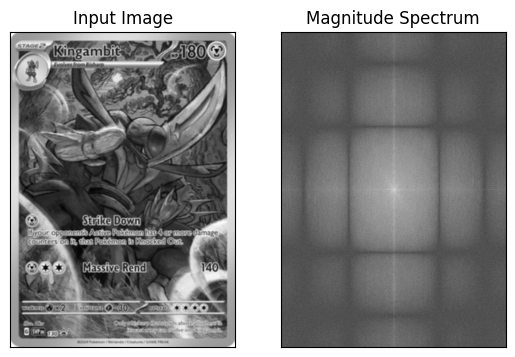

In [203]:
# Blur the grayscale image by a Guassian filter with kernel size of 10
imBlur = cv.blur(gray_image,(5,5))
# Transform the image to frequency domain
f = np.fft.fft2(imBlur)
# Bring the zero-frequency component to the center
fshift = np.fft.fftshift(f)
magnitude_spectrum = 30*np.log(np.abs(fshift))

plt.subplot(121),plt.imshow(imBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.show()

### TODO # 6: Generate a fourier transform on your grayscale image

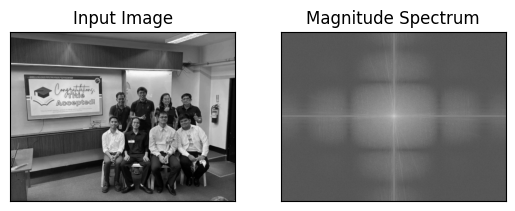

In [204]:
# todo: Implement your code here
# Blur the grayscale image by a Guassian filter with kernel size of 10
myimBlur = cv.blur(myGrayImg,(5,5))
# Transform the image to frequency domain
myf = np.fft.fft2(myimBlur)
# Bring the zero-frequency component to the center
myfshift = np.fft.fftshift(myf)
mymagnitude_spectrum = 30*np.log(np.abs(myfshift))

plt.subplot(121),plt.imshow(myimBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(mymagnitude_spectrum, cmap = 'gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.show()

### Step6: Finding Edges by Highpass Filtering in FFT

This section conduct high pass filtering to remove the low frequency component, resulting in a sharpening image which contains the edges

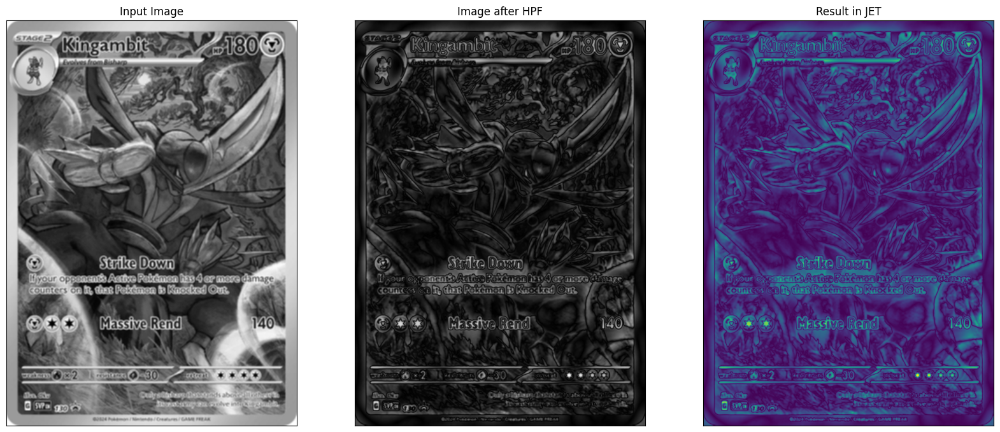

In [205]:
rows, cols = imBlur.shape
crow,ccol = round(rows/2) , round(cols/2)
# remove low frequencies with a rectangle size of 10
fshift[crow-10:crow+10, ccol-10:ccol+10] = 0
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)

plt.figure(figsize=([20, 20]))
plt.subplot(131),plt.imshow(imBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(img_back, cmap = 'gray')
plt.title('Image after HPF'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(img_back)
plt.title('Result in JET'), plt.xticks([]), plt.yticks([])
plt.show()

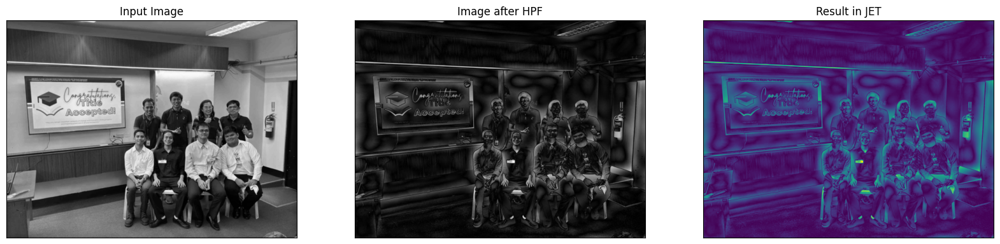

In [206]:
rows, cols = myimBlur.shape
crow,ccol = round(rows/2) , round(cols/2)
# remove low frequencies with a rectangle size of 10
myfshift[crow-10:crow+10, ccol-10:ccol+10] = 0
myf_ishift = np.fft.ifftshift(myfshift)
myimg_back = np.fft.ifft2(myf_ishift)
myimg_back = np.abs(myimg_back)

plt.figure(figsize=([20, 20]))
plt.subplot(131),plt.imshow(myimBlur, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(myimg_back, cmap = 'gray')
plt.title('Image after HPF'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(myimg_back)
plt.title('Result in JET'), plt.xticks([]), plt.yticks([])
plt.show()

## Step 4: Perform Tasks

### Task 1: Load and Display an Image
-	Identify the code cell where an image is loaded.
-	Replace the default image with another image of your choice (upload it to the Colab session).
-	Modify the code to load the new image and display it.


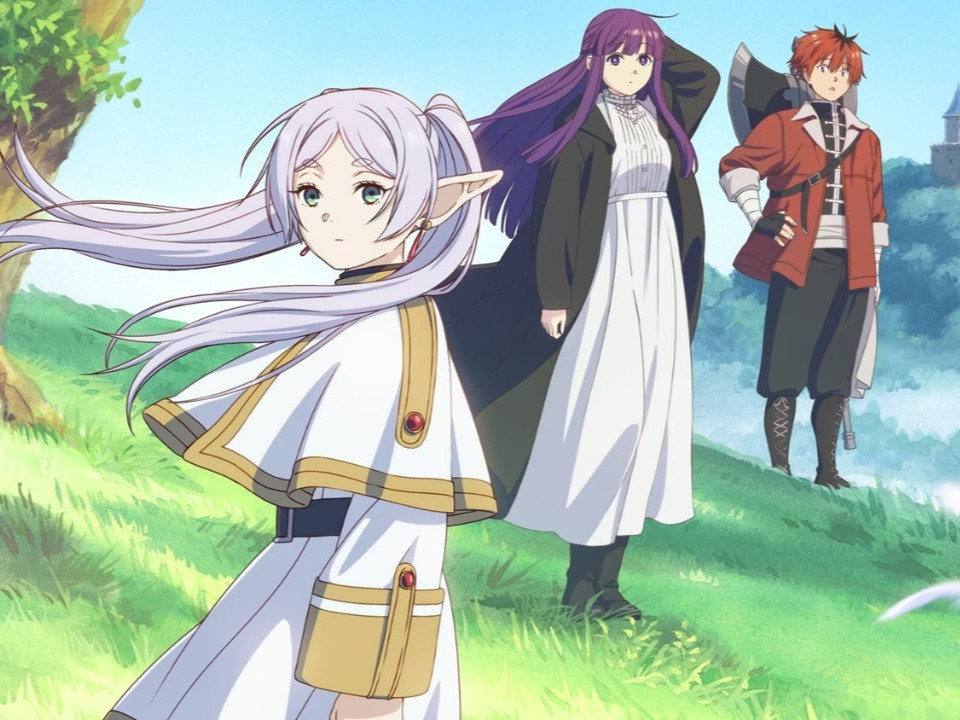

In [207]:
anime_url = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/anime.jpg"

# Read image from url, then convert into a NumPy array
anime_img = io.imread(anime_url)
# Convert image to from BGR (default of CV) to RGB format
anime_rgb_img = cv.cvtColor(anime_img, cv.COLOR_BGR2RGB)
# Show RGB image
cv2_imshow(anime_rgb_img)

### Task 2: Convert an Image to Grayscale
-	Run the cell where the image is converted to grayscale.
-	Add a new code cell below and save the grayscale image using OpenCV.


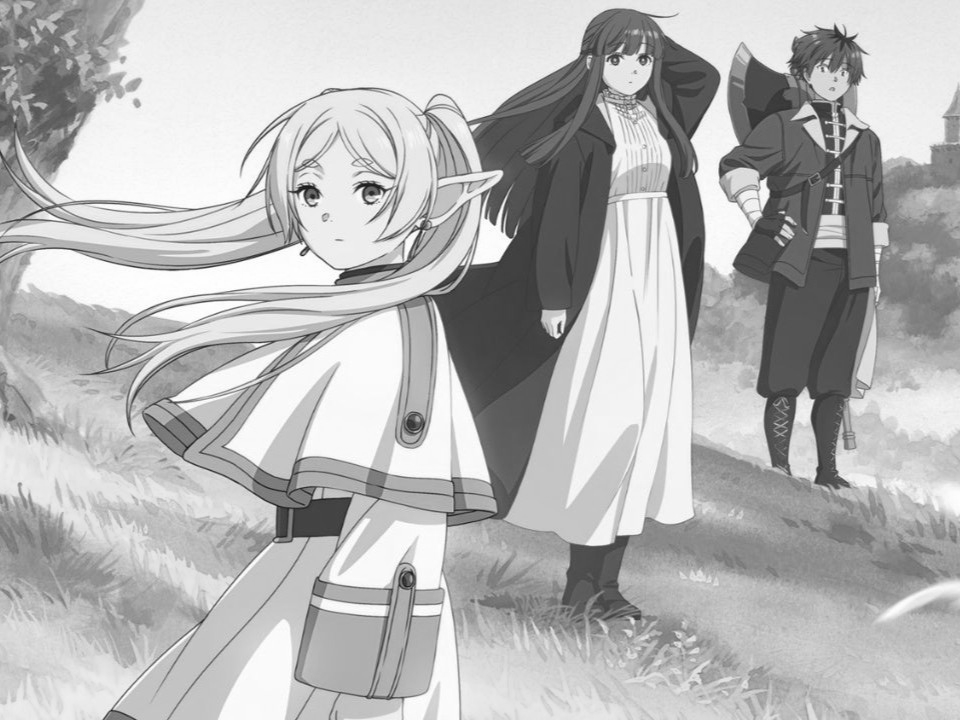

In [208]:
# Convert RGB image to Grayscale
anime_grayscale_img = cv.cvtColor(anime_rgb_img, cv.COLOR_RGB2GRAY)
cv2_imshow(anime_grayscale_img)

### Task 3: Apply Image Transformations
-	Experiment with transformations such as:
  -	Resizing
  - Rotation
  -	Cropping
- Document the effects of each transformation.


#### Resizing

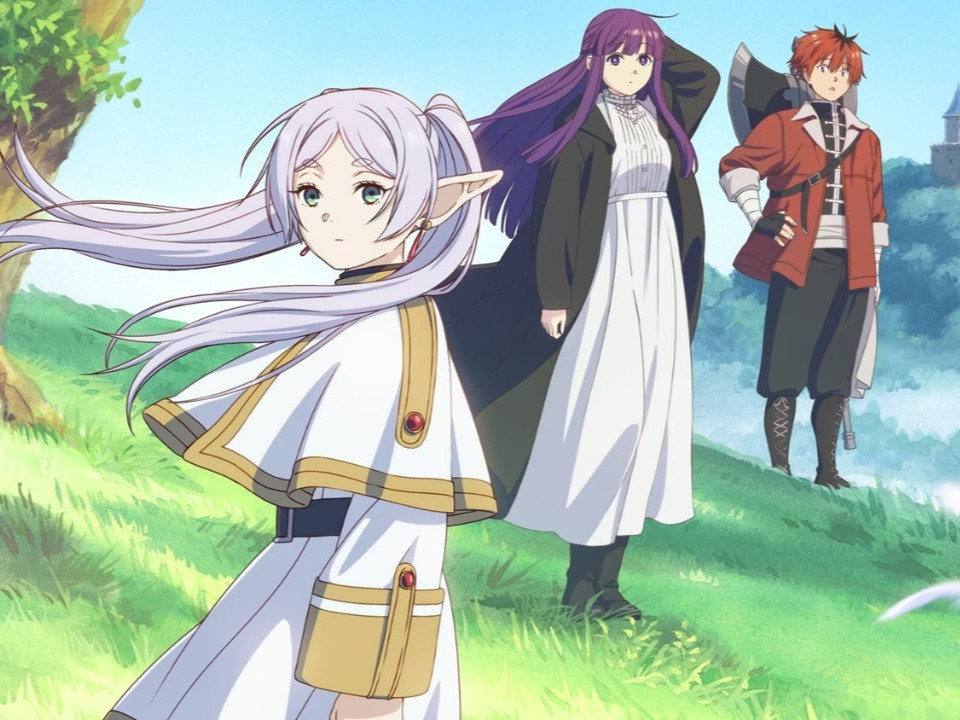

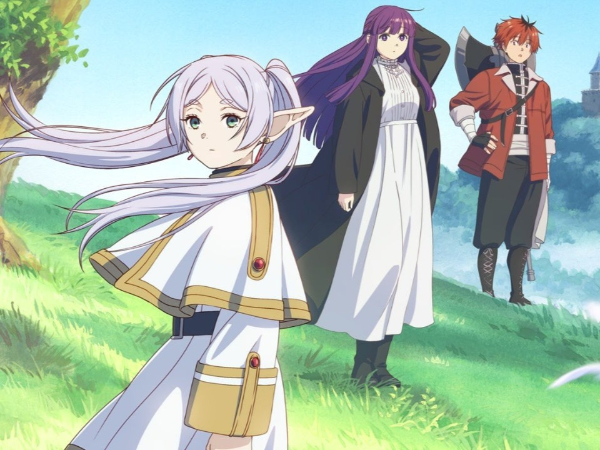

In [209]:
# Resize the image to 600x450
new_size=(600, 450)
anime_resized_img = cv.resize(anime_rgb_img, new_size)

# Show original image and resized image
cv2_imshow(anime_rgb_img)
cv2_imshow(anime_resized_img)

#### Rotation

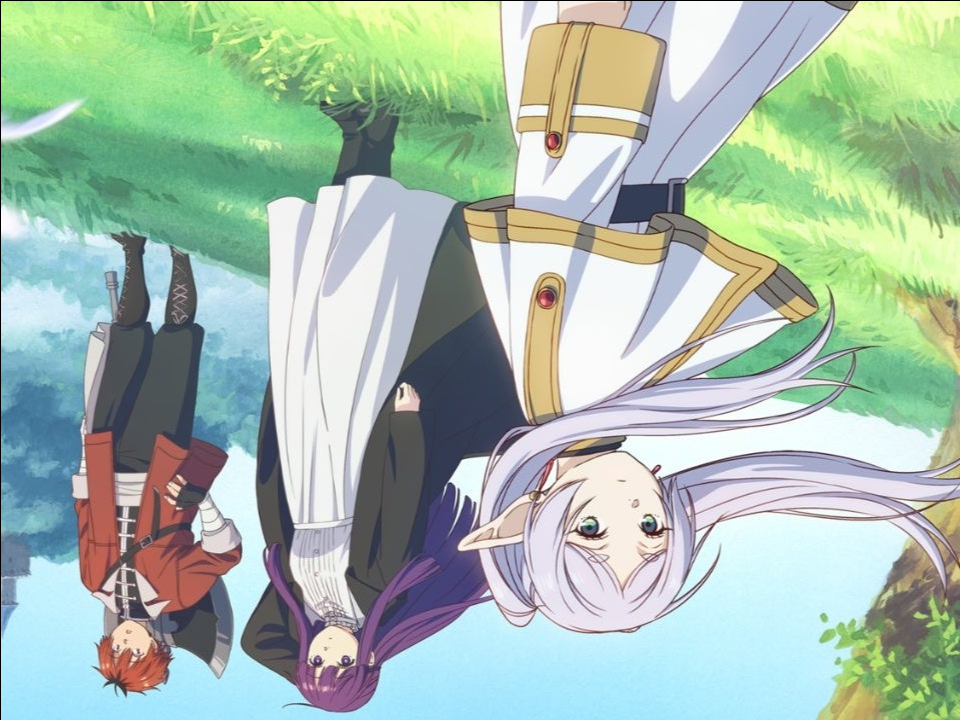

In [210]:
(h, w) = anime_rgb_img.shape[:2]  # Image dimensions
center = (w // 2, h // 2)  # Center of rotation

# Create rotation matrix
M = cv.getRotationMatrix2D(center, 180, 1.0)  # (center, angle, scale)

# Perform rotation
anime_rotated_img = cv.warpAffine(anime_rgb_img, M, (w, h))

# Show rotated image
cv2_imshow(anime_rotated_img)

#### Cropping

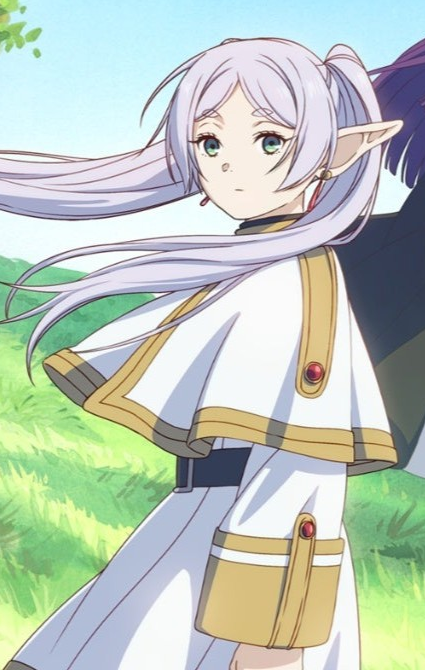

In [211]:
# Define the coordinates for the crop
x_start, y_start = 100, 50  # Top-left corner
x_end, y_end = 525, 1000     # Bottom-right corner

# Crop the image using slicing
cropped_img = anime_rgb_img[y_start:y_end, x_start:x_end]

# Display the cropped image
cv2_imshow(cropped_img)

### Task 4: Apply Filters
-	Explore the effects of:
  -	Blurring filters (e.g., GaussianBlur).
  -	Edge detection (e.g., Canny Edge Detection).
-	Comment on how these filters enhance or modify the image features.


#### Blurring Filters

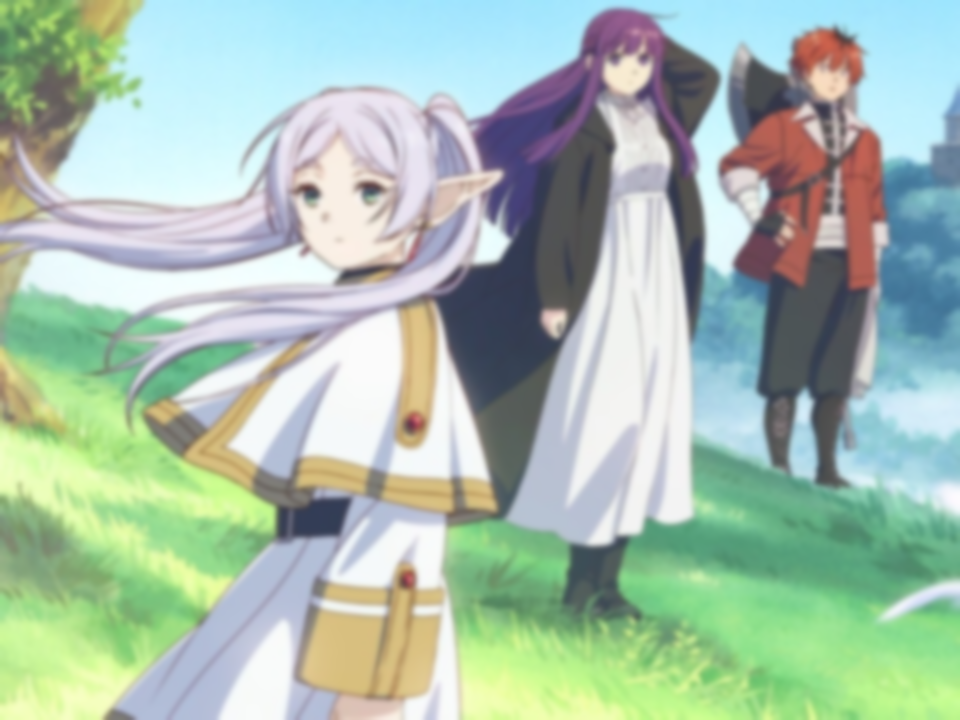

In [212]:
# Apply Gaussian Blur
# (15, 15) is the kernel size, 0 is the standard deviation
blurred_img = cv.GaussianBlur(anime_rgb_img, (15, 15), 0)

# Display the blurred image
cv2_imshow(blurred_img)

#### Edge Detection

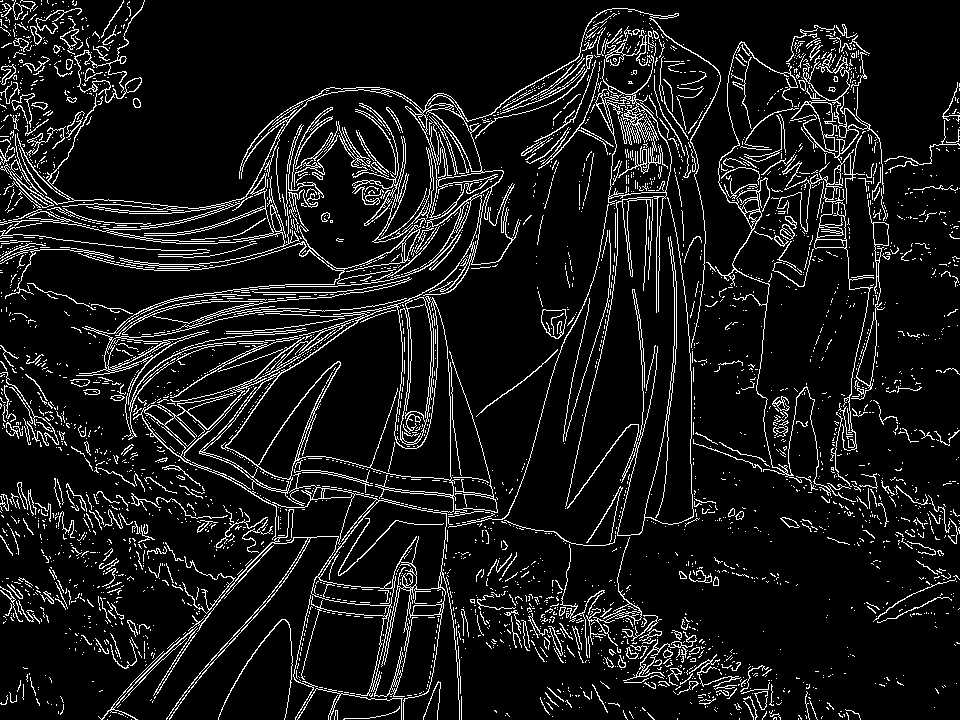

In [213]:
# Apply Canny Edge Detection
# threshold1: Triggers edge detection more easily, detects more edges (and noise)
# threshold2: Only detects the strongest edges
edges = cv.Canny(anime_rgb_img, threshold1=100, threshold2=100)

# Display the edges detected
cv2_imshow(edges)

## Step 5: Create a Mini-Project
Using the knowledge from the activity, create a short image processing pipeline. This pipeline should:
1.	Load an image.
2.	Perform at least three operations (e.g., resizing, grayscale conversion, edge detection).
3.	Display the final output alongside the original image.


In [228]:
class URL_Images_Processing_Pipeline():
    """
    A pipeline for processing images from URLs. This includes a variety of transformations like
    flipping, rotating, grayscale conversion, blurring, and edge detection. It applies the requested
    transformations to the images and displays them.

    Attributes:
        urls (list): List of image URLs to process.
        processes (list): List of processes to apply to images.
    """

    def __init__(self, processes=["flip horizontal", "flip vertical", "rotate", "grayscale", "blur", "edge"]):
        """
        Initializes the image processing pipeline.
        """
        self.urls = []
        self.images = {}  # Will hold images keyed by URL
        self.processes = processes
        self.processMap = {
            "grayscale": self.grayscale_images,
            "blur": self.blur_images,
            "edge": self.edge_images,
            "flip vertical": self.flip_vertical_images,
            "flip horizontal": self.flip_horizontal_images,
            "rotate": self.rotate_images
        }

    def run(self, urls=[]):
        """
        Loads images from the provided URLs, applies the selected processes, and displays the processed images.
        """
        self.urls = urls
        self.load_images()
        # Apply processes using the processMap
        for process in self.processes:
            if process not in self.processMap:
                continue
            # Call the respective function for each process
            self.processMap[process]()
        # Display images after processing all
        self.display_images()

    def load_images(self):
        """
        Loads images from the specified URLs into the images dictionary.
        Each image is loaded as an RGB image from its URL and stored under the "original" key.
        """
        for url in self.urls:
            rgb_image = io.imread(url)
            self.images[url] = {"original": rgb_image}

    def grayscale_images(self):
        """
        Converts all loaded images to grayscale.
        The grayscale version of each image is stored in the dictionary under the "grayscale" key.
        """
        for url in self.urls:
            original = self.images[url]["original"]
            gray_image = cv.cvtColor(original, cv.COLOR_RGB2GRAY)
            self.images[url]["grayscale"] = gray_image

    def blur_images(self):
        """
        Applies a Gaussian blur to all loaded images.
        The blurred version of each image is stored in the dictionary under the "blur" key.
        """
        for url in self.urls:
            original = self.images[url]["original"]
            blurred_image = cv.GaussianBlur(original, (35, 35), 5)  # Apply Gaussian Blur
            self.images[url]["blur"] = blurred_image

    def edge_images(self):
        """
        Applies Canny edge detection to all loaded images.
        If a grayscale version is not available, it will first convert the image to grayscale.
        The edge-detected version of each image is stored under the "edges" key.
        """
        for url in self.urls:
            gray = self.images[url].get("grayscale")
            if gray is None:
                gray = cv.cvtColor(self.images[url]["original"], cv.COLOR_RGB2GRAY)
            edges = cv.Canny(gray, 100, 200)  # Apply Canny Edge Detection
            self.images[url]["edges"] = edges

    def flip_vertical_images(self):
        """
        Flips all images vertically.
        The vertically flipped version of each image is stored under the "flip vertical" key.
        """
        for url in self.urls:
            original = self.images[url]["original"]
            flipped_vert = cv.flip(original, 0)  # Flip image vertically
            self.images[url]["flip vertical"] = flipped_vert

    def flip_horizontal_images(self):
        """
        Flips all images horizontally.
        The horizontally flipped version of each image is stored under the "flip horizontal" key.
        """
        for url in self.urls:
            original = self.images[url]["original"]
            flipped_horiz = cv.flip(original, 1)  # Flip image horizontally
            self.images[url]["flip horizontal"] = flipped_horiz

    def rotate_images(self):
        """
        Rotates all images by 180 degrees.
        The rotated version of each image is stored under the "rotate" key.
        """
        for url in self.urls:
            original = self.images[url]["original"]
            rotated = cv.rotate(original, cv.ROTATE_180)  # Rotate image by 180 degrees
            self.images[url]["rotate"] = rotated

    def display_images(self):
        """
        Displays all processed images using Matplotlib.
        Each processed image is displayed in a subplot with its corresponding process name as the title.
        """
        for image_number, url in enumerate(self.urls, 1):
            # Calculate rows and columns for subplot grid
            n_cols = len(self.images[url])
            n_rows = 1

            # Create figure with appropriate size
            plt.figure(figsize=(15, 5 * n_rows))

            # Plot each image for current URL
            for idx, (process_name, img) in enumerate(self.images[url].items(), 1):
                plt.subplot(n_rows, n_cols, idx)

                # Handle different image types (RGB vs grayscale)
                if len(img.shape) == 2:  # Grayscale image
                    plt.imshow(img, cmap='gray')
                else:  # RGB image
                    plt.imshow(img)

                plt.title(f'{process_name.title()}')
                plt.axis('off')

            plt.tight_layout()
            plt.show()

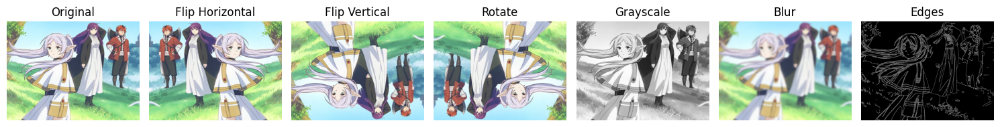

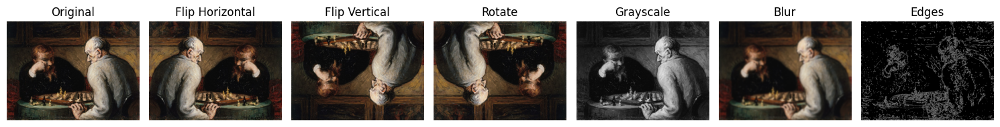

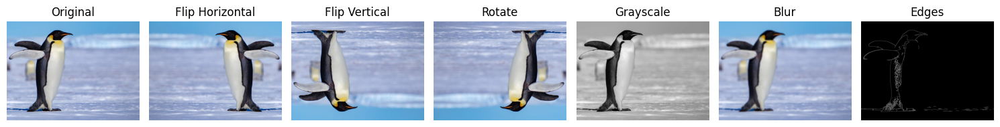

In [232]:
url1 = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/anime.jpg"
url2 = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/chess.jpg"
url3 = "https://raw.githubusercontent.com/SiegfredLorelle/digital-image-processing/refs/heads/main/lab01_introduction-to-image-processing/data/penguin.jpg"
urls = [url1, url2, url3]

pipeline = URL_Images_Processing_Pipeline()
pipeline.run(urls)